# Importing Required Libraries

The Libraries include Basic Processing, Basic Data Visualization, Model Parameters, Preprocessing, Model Building libraries etc...

In [1]:
#Data Processing Imports
import pandas as pd
import numpy as np

# Data Visualisation Imports
import matplotlib.pyplot as plt
import seaborn as sns

# Importing Model Parameters
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.dummy import DummyClassifier

# Data preprocessing
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OrdinalEncoder
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.feature_selection import SelectKBest, f_classif

# Machine learning models
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from xgboost import XGBClassifier

# Suppress warnings, To remove Non-critical warnings/messages
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/System-Threat-Forecaster/sample_submission.csv
/kaggle/input/System-Threat-Forecaster/train.csv
/kaggle/input/System-Threat-Forecaster/test.csv


# Loading the Data

Loading the data for prediction of the system’s probability of getting infected by various families of malware, based on different properties of that system.

## Loading Train Data

Reading the Train Data file of the System Threat Forecaster.

In [2]:
train_data = pd.read_csv('/kaggle/input/System-Threat-Forecaster/train.csv')
train_data.head()

,MachineID,ProductName,EngineVersion,AppVersion,SignatureVersion,IsBetaUser,RealTimeProtectionState,IsPassiveModeEnabled,AntivirusConfigID,NumAntivirusProductsInstalled,...,IsSecureBootEnabled,IsVirtualDevice,IsTouchEnabled,IsPenCapable,IsAlwaysOnAlwaysConnectedCapable,IsGamer,RegionIdentifier,DateAS,DateOS,target
0,f541bae429089117c4aac39c90dd3416,win8defender,1.1.15200.1,4.18.1807.18075,1.275.1003.0,0,7.0,0,53447.0,1.0,...,0,0.0,1,0,1.0,0.0,6.0,2018-09-10 10:11:00,2018-04-17,0
1,dc2b14d9ce3a0ce4050bb640190f2ca5,win8defender,1.1.15100.1,4.18.1807.18075,1.273.1465.0,0,7.0,0,53447.0,1.0,...,1,0.0,0,0,0.0,0.0,10.0,2018-08-16 00:01:00,2018-08-14,1
2,fd20c5f010e9c5f91ad1c6b3e0da68a0,win8defender,1.1.15200.1,4.18.1807.18075,1.275.1546.0,0,7.0,0,53447.0,1.0,...,0,0.0,0,0,0.0,1.0,6.0,2018-09-20 23:20:00,2018-09-11,1
3,38711eae85eb77a72ec5dfdf27eb2a76,win8defender,1.1.15200.1,4.12.17007.18011,1.275.1141.0,0,7.0,0,46413.0,2.0,...,1,0.0,0,0,0.0,0.0,12.0,2018-09-14 00:32:00,2018-01-03,1
4,32607c9a543a9214e2c7e45800ed4849,win8defender,1.1.15200.1,4.13.17134.228,1.275.1283.0,0,7.0,0,40466.0,2.0,...,0,0.0,0,0,0.0,1.0,7.0,2018-09-15 19:34:00,2018-09-11,0


## Loading Test Data

Reading the Test Data file of the System Threat Forecaster.

In [3]:
test_data = pd.read_csv('/kaggle/input/System-Threat-Forecaster/test.csv')
test_data.head()

,MachineID,ProductName,EngineVersion,AppVersion,SignatureVersion,IsBetaUser,RealTimeProtectionState,IsPassiveModeEnabled,AntivirusConfigID,NumAntivirusProductsInstalled,...,FirmwareVersionID,IsSecureBootEnabled,IsVirtualDevice,IsTouchEnabled,IsPenCapable,IsAlwaysOnAlwaysConnectedCapable,IsGamer,RegionIdentifier,DateAS,DateOS
0,c2c61173092ad20db5585ca8c10de6e0,win8defender,1.1.15100.1,4.18.1807.18075,1.273.1276.0,0,7.0,0,53447.0,1.0,...,48751.0,0,0.0,0,0,0.0,1.0,11.0,2018-08-12 13:12:00,2018-07-10
1,2e6bb5362ba1ce897feeb1de5edea686,win8defender,1.1.15100.1,4.10.209.0,1.273.371.0,0,7.0,0,46184.0,2.0,...,64709.0,1,0.0,0,0,0.0,0.0,12.0,2018-07-26 06:54:00,2016-10-11
2,692649baed1c50bb8d051ae7f06e3625,win8defender,1.1.15200.1,4.18.1807.18075,1.275.263.0,0,7.0,0,51954.0,2.0,...,33094.0,1,0.0,0,0,0.0,0.0,10.0,2018-08-27 17:29:00,2018-05-08
3,2ff95e7d97e9f80ec81c97622dd93ed6,win8defender,1.1.15300.6,4.18.1807.18075,1.277.58.0,0,7.0,0,41571.0,2.0,...,26184.0,1,0.0,0,0,0.0,0.0,10.0,2018-09-25 22:13:00,2018-05-08
4,256766b4c5011e146f05b323863e08a4,win8defender,1.1.14800.3,4.14.17639.18041,1.267.898.0,0,7.0,0,40645.0,3.0,...,12126.0,0,0.0,0,0,0.0,0.0,7.0,2018-05-06 01:31:00,2018-06-12


## Dummy Classifier

Initial Code used for the Dummy Classifier.

In [4]:
# df = pd.read_csv('/kaggle/input/System-Threat-Forecaster/train.csv') 
# X = df.drop("target", axis=1)
# y = df['target']
# model = DummyClassifier().fit(X,y)
# X_test = pd.read_csv('/kaggle/input/System-Threat-Forecaster/test.csv')
# y_pred = model.predict(X_test)
# submission= pd.DataFrame({"id": range (0,X_test.shape[0]),
# "target": y_pred})
# submission.to_csv('submission.csv',index=False)

# The Explanatory Data Analysis

To analyze the datasets and to summarize their main characteristics, often with visual methods. Helps uncover patterns, spot anomalies, test assumptions, and check the validity of statistical models.

## Shape of the data

The dataset consists of 76 columns, giving us a relatively large feature set to work with.


In [5]:
print(f"Train Dataset contains {train_data.shape[0]} rows and {train_data.shape[1]} columns.")
print(f"Test Dataset contains {test_data.shape[0]} rows and {test_data.shape[1]} columns.")

Train Dataset contains 100000 rows and 76 columns.
Test Dataset contains 10000 rows and 75 columns.


## Basic Information
The dataset contains various feature types, including both numeric and categorical features, which will require different preprocessing techniques.


In [6]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 76 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   MachineID                           100000 non-null  object 
 1   ProductName                         100000 non-null  object 
 2   EngineVersion                       100000 non-null  object 
 3   AppVersion                          100000 non-null  object 
 4   SignatureVersion                    100000 non-null  object 
 5   IsBetaUser                          100000 non-null  int64  
 6   RealTimeProtectionState             99934 non-null   float64
 7   IsPassiveModeEnabled                100000 non-null  int64  
 8   AntivirusConfigID                   99924 non-null   float64
 9   NumAntivirusProductsInstalled       99924 non-null   float64
 10  NumAntivirusProductsEnabled         99924 non-null   float64
 11  HasTpm                     

## Total Number of 'Nan' values in the dataset

Showing how many missing values (NaNs) exist across the entire dataset, which helps in understanding the level of data cleanliness.

In [7]:
print("Total Number of Nan values: ")
train_data.isna().sum().sum()

Total Number of Nan values: 


6533

## Total number of 'Nan' values in each column

This breakdown reveals which specific columns contain missing values, guiding decisions on how to handle them, like imputation or removal.

**It can be concluded from the below context that we have missing values only in the three columns.**

**Columns: {IsGamer, RegionIdentifier,DateOS}**

In [8]:
train_data.isna().sum()

MachineID             0
ProductName           0
EngineVersion         0
AppVersion            0
SignatureVersion      0
                   ... 
IsGamer             559
RegionIdentifier    559
DateAS                0
DateOS               24
target                0
Length: 76, dtype: int64

## Checking for Duplicate data

Identifying whether there are any duplicate rows in the dataset, which can lead to bias and affect model performance.

In [9]:
duplicate_rows = train_data.duplicated()
print("Number of duplicates: ",duplicate_rows.sum())


Number of duplicates:  165


## Statistical summary

Gives a summary of numeric features, such as mean, median, standard deviation, min, max, and quartiles, providing insight into the distribution of the data.

In [10]:
train_data.describe()

,IsBetaUser,RealTimeProtectionState,IsPassiveModeEnabled,AntivirusConfigID,NumAntivirusProductsInstalled,NumAntivirusProductsEnabled,HasTpm,CountryID,CityID,GeoRegionID,...,FirmwareManufacturerID,FirmwareVersionID,IsSecureBootEnabled,IsVirtualDevice,IsTouchEnabled,IsPenCapable,IsAlwaysOnAlwaysConnectedCapable,IsGamer,RegionIdentifier,target
count,100000.0,99934.000000,100000.000000,99924.000000,99924.000000,99924.000000,100000.000000,100000.000000,99377.000000,100000.000000,...,99624.000000,99666.000000,100000.000000,99980.000000,100000.000000,100000.000000,99866.000000,99441.000000,99441.000000,100000.000000
mean,0.0,6.848430,0.017620,47975.710440,1.326528,1.018264,0.996780,108.078790,81029.938587,169.741630,...,401.987613,32942.648044,0.495690,0.003841,0.128470,0.040580,0.058398,0.296668,7.875866,0.505250
std,0.0,1.015166,0.131566,13803.321533,0.520681,0.155291,0.056654,63.062151,48944.027074,89.188929,...,221.318891,21151.970827,0.499984,0.061855,0.334614,0.197316,0.234496,0.456791,4.562533,0.499975
min,0.0,0.000000,0.000000,39.000000,1.000000,0.000000,0.000000,1.000000,7.000000,1.000000,...,2.000000,121.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,0.0,7.000000,0.000000,49480.000000,1.000000,1.000000,1.000000,51.000000,36694.000000,89.000000,...,142.000000,13020.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.000000
50%,0.0,7.000000,0.000000,53447.000000,1.000000,1.000000,1.000000,97.000000,82373.000000,181.000000,...,500.000000,33066.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000,1.000000
75%,0.0,7.000000,0.000000,53447.000000,2.000000,1.000000,1.000000,162.000000,122835.000000,267.000000,...,556.000000,52357.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,11.000000,1.000000
max,0.0,8.000000,1.000000,70490.000000,5.000000,4.000000,1.000000,222.000000,167957.000000,296.000000,...,1083.000000,72091.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,15.000000,1.000000


## Some Visible Insights
**Feature Variety:**
The dataset includes both categorical (e.g., "IsBetaUser") and numerical features (e.g., "NumAntivirusProductsInstalled"), requiring different preprocessing techniques.

**Imbalance in 'IsPassiveModeEnabled':** 
Most of the data in the "IsPassiveModeEnabled" column is 0 (inactive), indicating a skewed distribution that might require special treatment during modeling.

**Range of Values:** 
Columns like "NumAntivirusProductsInstalled" vary from 1 to 5, showing diverse antivirus configurations among the users.

**Geographical Features:** 
"CountryID" and "CityID" show a broad range of values, indicating a geographically diverse user base.

**Secure Features:** 
A significant portion of the data (around 50%) has "IsSecureBootEnabled" set to 0, suggesting that many users do not have secure boot enabled.

**Target Variable Distribution:**
The target variable appears balanced, with a near 50% split (mean close to 0.5), implying no significant class imbalance.

**Outliers in Numerical Features:**
Columns like "NumAntivirusProductsEnabled" show values that suggest possible outliers (e.g., max of 4 in some cases), which might need further inspection or handling.

## Distribution Pattern of Numeric Features

Visualizing the distribution of all **48 numeric features** revealing skewness, normality, or outliers in the data.

In [11]:
# Select numerical columns
numerical_columns = train_data.select_dtypes(exclude=['object', 'category']).columns.tolist()

# Setting Seaborn style
sns.set_theme(style="darkgrid")
plt.style.use('dark_background')

# Defining subplot layout: 2 columns
num_cols = 2  
num_rows = (len(numerical_columns) + num_cols - 1) // num_cols  # Auto-calculate rows

# Creating figure and axes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, num_rows * 4), dpi=300)
axes = axes.flatten()  # Flatten for easy indexing

# Plotting histograms
for i, col in enumerate(numerical_columns):
    axes[i].hist(train_data[col], bins=20, edgecolor='black', color=sns.color_palette("cubehelix")[3])
    axes[i].set_title(f'Distribution of {col}', fontsize=12, color='white')
    axes[i].tick_params(axis='both', colors='white')

# Removing extra subplots
for i in range(len(numerical_columns), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


## Checking the frequency of categories in categorical columns

Showing how frequently each category  values appears in categorical variables, which is useful for understanding imbalances or common classes.

In [12]:
# Selecting categorical columns
categorical_columns = train_data.select_dtypes(include=['object', 'category']).columns.tolist()

# Limiting all the number of categories displayed per column
max_categories = 28  

# Defining layout: 2 columns per row
num_cols = 1
num_rows = (len(categorical_columns) + num_cols - 1) // num_cols

# Creating the figure
fig, axes = plt.subplots(num_rows, num_cols, figsize=(14, num_rows * 4), dpi=500)
axes = axes.flatten()

# Plotting each categorical feature
for i, col in enumerate(categorical_columns):
    unique_values = train_data[col].nunique()
    
    # Limiting categories if too many
    if unique_values > max_categories:
        top_categories = train_data[col].value_counts().nlargest(max_categories).index
        subset = train_data[train_data[col].isin(top_categories)]
    else:
        subset = train_data
    
    sns.countplot(y=subset[col], palette='flare', ax=axes[i])
    axes[i].set_title(f'Distribution of {col}', fontsize=12)
    axes[i].tick_params(axis='y', rotation=0)

# Removing unused subplots (if any)
for i in range(len(categorical_columns), len(axes)):
    fig.delaxes(axes[i])

# Adjusting layout
plt.tight_layout()
plt.show()


## Target Variable Distribution

Examining the distribution of the target variable helps understand if the classes are balanced, which is crucial for choosing the right model and evaluation metric.

Value Distubution
target
1    50525
0    49475
Name: count, dtype: int64

Percentage Distubution
target
1    50.525
0    49.475
Name: proportion, dtype: float64


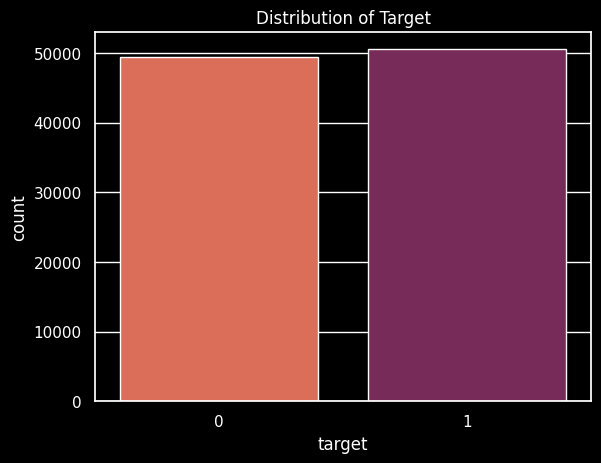

In [13]:
print("Value Distubution")
print(train_data['target'].value_counts())
print()
print("Percentage Distubution")
print(train_data['target'].value_counts(normalize=True)*100)

# Plotting the target variable distribution i.e. actual imbalanced values
sns.countplot(x='target', data=train_data, palette='rocket_r')
plt.title('Distribution of Target')
plt.show()

## Correlation Heatmap with Target Column

The heatmap showing the correlations between features and the target variable, highlighting which features are most influential in predicting the target.

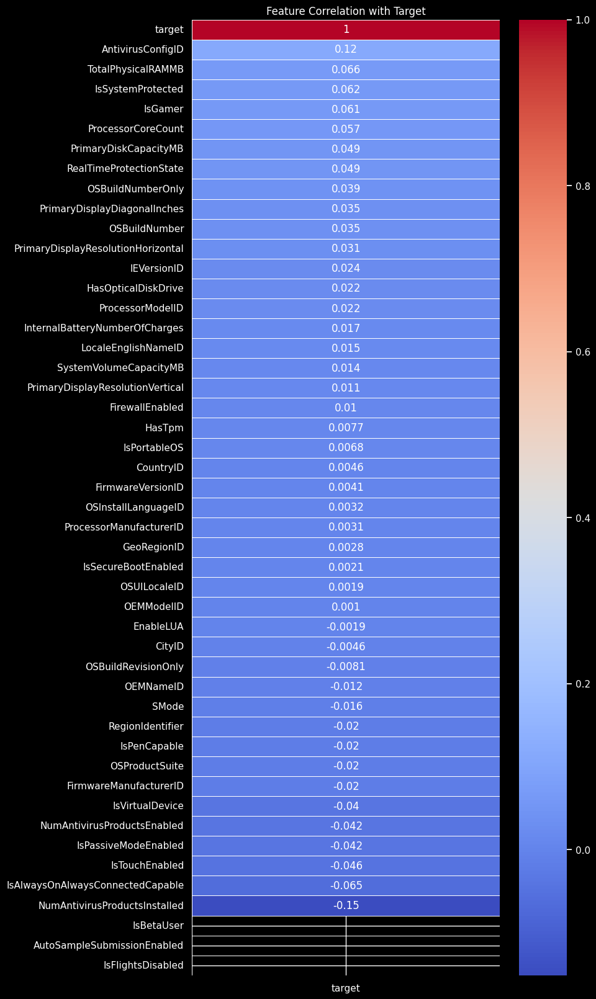

In [14]:
numeric_df = train_data.select_dtypes(include=['int64', 'float64'])

# Computing Pearson correlation matrix
correlation_matrix = numeric_df.corr()    
correlation_matrix
plt.figure(figsize=(8,20))

# Plotting correlation of features with the target
sns.heatmap(correlation_matrix[['target']].sort_values(by='target', ascending=False), 
            annot=True, cmap='coolwarm', linewidths=0.5)
plt.title("Feature Correlation with Target")
plt.show()

## Outlier Detection

Identifying outliers ensures that extreme values don't distort model predictions. Box plot is used here to detect them in the dataset.

In [15]:
plt.style.use('classic')

numerical_cols = train_data.select_dtypes(exclude=['object', 'category']).columns.tolist()

num_cols = 2  
num_rows = (len(numerical_cols) + num_cols - 1) // num_cols

fig = plt.figure(figsize=(14, num_rows * 4), dpi=300)

# Plotting boxplots dynamically (only create required subplots)
for i, col in enumerate(numerical_cols):
    ax = fig.add_subplot(num_rows, num_cols, i + 1)
    sns.boxplot(x=train_data['target'], y=train_data[col], palette='flare', ax=ax)
    ax.set_title(f'{col} vs target', fontsize=12)
    ax.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()


# **Data Cleaning/Preprocessing**

## Removing Duplicate Values

Removing duplicate values to ensure that each row in the dataset represents a unique observation, preventing bias during model training. Duplicates can distort statistical analyses and lead to overfitting.

In [16]:
duplicate_rows = train_data.duplicated()
print("Number of duplicates then: ",duplicate_rows.sum())
train_data = train_data.drop_duplicates()
print("Number of duplicates now: ",train_data.duplicated().sum())

Number of duplicates then:  165
Number of duplicates now:  0


## Separate features and target

Separating features and the target variable is crucial for training machine learning models, as the model needs to learn from the input features (independent variables) to predict the target (dependent variable). The target variable should be isolated from the rest of the dataset before training the model.

In [17]:
X = train_data.drop(['target'], axis=1)
y = train_data['target']

## Identify numerical and categorical features

Identifying numerical and categorical features is an essential step in data preprocessing as it guiding how to handle each type during model training.

In [18]:
num_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
cat_features = X.select_dtypes(include=['object']).columns.tolist()

## Handle numerical features (encoding + missing values)

Handling missing values in numerical features can be done using imputation (e.g., mean or median) to replace missing entries.

In [19]:
num_transformer = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

## Handle categorical features (encoding + missing values)

For categorical features, missing values can be handled using imputation techniques like replacing them with the most frequent category or using a placeholder like "Unknown". 

In [20]:
cat_transformer = Pipeline([
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1))
])

## Combine transformations

To combine transformations for both numerical and categorical features in a single workflow.

In [21]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', num_transformer, num_features),
        ('cat', cat_transformer, cat_features)
    ],
    remainder= 'passthrough'
)

## Feature Selection (Adjust k value as needed)

Feature Selection for selecting the most relevant features to improve model performance, reduce overfitting, and decrease computation time.

In [22]:
k_best = SelectKBest(score_func=f_classif, k=57)

## Spliting the dataset (Train-test split)

Splitting the dataset into training and testing sets as it is a crucial step to evaluate the performance of our machine learning models.


In [23]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.15, random_state=42)

In [24]:
X_test = test_data.copy()
X_test.head()

,MachineID,ProductName,EngineVersion,AppVersion,SignatureVersion,IsBetaUser,RealTimeProtectionState,IsPassiveModeEnabled,AntivirusConfigID,NumAntivirusProductsInstalled,...,FirmwareVersionID,IsSecureBootEnabled,IsVirtualDevice,IsTouchEnabled,IsPenCapable,IsAlwaysOnAlwaysConnectedCapable,IsGamer,RegionIdentifier,DateAS,DateOS
0,c2c61173092ad20db5585ca8c10de6e0,win8defender,1.1.15100.1,4.18.1807.18075,1.273.1276.0,0,7.0,0,53447.0,1.0,...,48751.0,0,0.0,0,0,0.0,1.0,11.0,2018-08-12 13:12:00,2018-07-10
1,2e6bb5362ba1ce897feeb1de5edea686,win8defender,1.1.15100.1,4.10.209.0,1.273.371.0,0,7.0,0,46184.0,2.0,...,64709.0,1,0.0,0,0,0.0,0.0,12.0,2018-07-26 06:54:00,2016-10-11
2,692649baed1c50bb8d051ae7f06e3625,win8defender,1.1.15200.1,4.18.1807.18075,1.275.263.0,0,7.0,0,51954.0,2.0,...,33094.0,1,0.0,0,0,0.0,0.0,10.0,2018-08-27 17:29:00,2018-05-08
3,2ff95e7d97e9f80ec81c97622dd93ed6,win8defender,1.1.15300.6,4.18.1807.18075,1.277.58.0,0,7.0,0,41571.0,2.0,...,26184.0,1,0.0,0,0,0.0,0.0,10.0,2018-09-25 22:13:00,2018-05-08
4,256766b4c5011e146f05b323863e08a4,win8defender,1.1.14800.3,4.14.17639.18041,1.267.898.0,0,7.0,0,40645.0,3.0,...,12126.0,0,0.0,0,0,0.0,0.0,7.0,2018-05-06 01:31:00,2018-06-12


# **Model Building**


## Baseline Model (Logistic Regression)

Using Logistic Regression helps as a baseline, modeling the relationship between the features and the target variable, allowing the prediction of binary outcomes based on input features.

Accuracy: 0.5971

Classification Report:
              precision    recall  f1-score   support

           0       0.61      0.50      0.55      7402
           1       0.59      0.69      0.64      7574

    accuracy                           0.60     14976
   macro avg       0.60      0.60      0.59     14976
weighted avg       0.60      0.60      0.59     14976



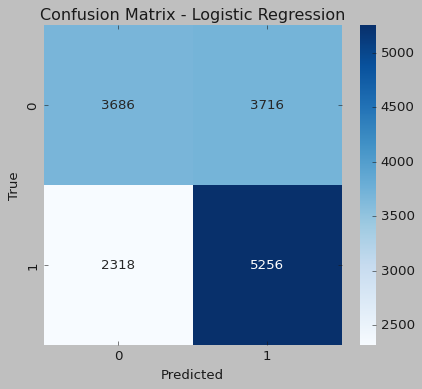

In [25]:
# Defining model Logistic Regression
LR_model = Pipeline([
    ('preprocessing', preprocessor),
    ('feature_selection', k_best),
    ('classifier', LogisticRegression(random_state=42, max_iter=800))
])

# Fit the model
LR_model.fit(X_train, y_train)

# Predictions
y_pred = LR_model.predict(X_val)

# Accuracy score
accuracy = accuracy_score(y_val, y_pred)
print(f'Accuracy: {accuracy:.4f}')

# Classification report (Precision, Recall, F1-score)
print("\nClassification Report:")
print(classification_report(y_val, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_val, y_pred)

# Visualize Confusion Matrix using Seaborn heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix - Logistic Regression')
plt.show()

## Model 1 (RandomForest Classifier)

Using Random Forest to help by creating an ensemble of decision trees, which improves prediction accuracy and reduces overfitting by averaging multiple trees' outputs. It also provides feature importance, allowing us to identify which features are most influential in predicting the target variable.

Accuracy: 0.6150

Classification Report:
              precision    recall  f1-score   support

           0       0.61      0.61      0.61      7402
           1       0.62      0.62      0.62      7574

    accuracy                           0.61     14976
   macro avg       0.61      0.61      0.61     14976
weighted avg       0.61      0.61      0.61     14976



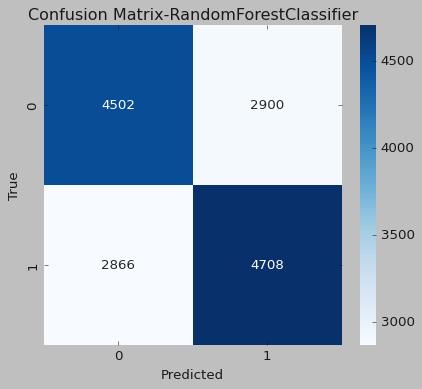

In [26]:
# Defining model RandomForest Classifier
RF_model = Pipeline([
    ('preprocessing', preprocessor),
    ('feature_selection', k_best),
    ('classifier', RandomForestClassifier(random_state=42))
])

# Fit the model
RF_model.fit(X_train, y_train)

# Predictions
y_pred = RF_model.predict(X_val)

# Accuracy score
accuracy = accuracy_score(y_val, y_pred)
print(f'Accuracy: {accuracy:.4f}')

# Classification report (Precision, Recall, F1-score)
print("\nClassification Report:")
print(classification_report(y_val, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_val, y_pred)

# Visualize Confusion Matrix using Seaborn heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix-RandomForestClassifier')
plt.show()

## Model 2 (AdaBoost Classifier)
Using AdaBoost to improve prediction accuracy by combining multiple weak learners (typically decision trees) into a strong learner. It focuses on correcting the errors made by previous models by adjusting the weights of misclassified data points, enhancing overall model performance, especially in difficult cases.

Accuracy: 0.6183

Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.54      0.58      7402
           1       0.61      0.70      0.65      7574

    accuracy                           0.62     14976
   macro avg       0.62      0.62      0.62     14976
weighted avg       0.62      0.62      0.62     14976



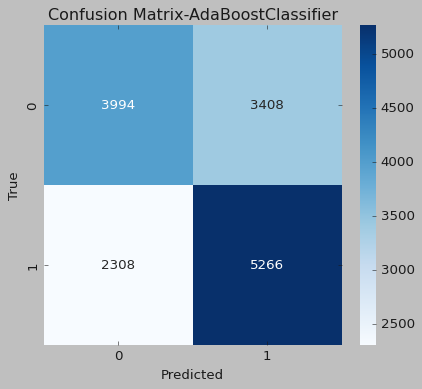

In [27]:
# Defining model AdaBoost Classifier
AB_model = Pipeline([
    ('preprocessing', preprocessor),
    ('feature_selection', k_best),
    ('classifier', AdaBoostClassifier(random_state=42))
])

# Fit the model
AB_model.fit(X_train, y_train)

# Predictions
y_pred = AB_model.predict(X_val)

# Accuracy score
accuracy = accuracy_score(y_val, y_pred)
print(f'Accuracy: {accuracy:.4f}')

# Classification report (Precision, Recall, F1-score)
print("\nClassification Report:")
print(classification_report(y_val, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_val, y_pred)

# Visualize Confusion Matrix using Seaborn heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix-AdaBoostClassifier')
plt.show()

## Model 3 (XGBoost Classifier)
XGBoost helps by leveraging gradient boosting techniques to create a powerful ensemble of decision trees. It minimizes errors by iteratively adding trees that correct the mistakes of previous ones, and it’s known for its efficiency, scalability, and high performance, making it particularly effective for large, complex datasets.

Accuracy: 0.6243

Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.58      0.61      7402
           1       0.62      0.66      0.64      7574

    accuracy                           0.62     14976
   macro avg       0.62      0.62      0.62     14976
weighted avg       0.62      0.62      0.62     14976



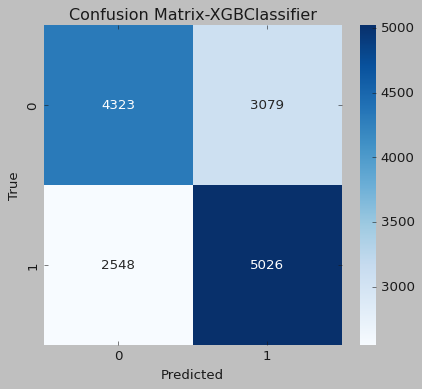

In [28]:
# Defining model XGB Classifier
XGB_model = Pipeline([
    ('preprocessing', preprocessor),
    ('feature_selection', k_best),
    ('classifier', XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42))
])

# Fit the model
XGB_model.fit(X_train, y_train)

# Predictions
y_pred = XGB_model.predict(X_val)

# Accuracy score
accuracy = accuracy_score(y_val, y_pred)
print(f'Accuracy: {accuracy:.4f}')

# Classification report (Precision, Recall, F1-score)
print("\nClassification Report:")
print(classification_report(y_val, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_val, y_pred)

# Visualize Confusion Matrix using Seaborn heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix-XGBClassifier')
plt.show()

## Comparing the Models

Comparing all three models to choose the best model for the better results. Each model is effective for different situations, and comparing their performance helps to identify which one performs best for the given task.


Evaluating Random Forest...

Accuracy for Random Forest: 0.6150

Classification Report:
              precision    recall  f1-score   support

           0       0.61      0.61      0.61      7402
           1       0.62      0.62      0.62      7574

    accuracy                           0.61     14976
   macro avg       0.61      0.61      0.61     14976
weighted avg       0.61      0.61      0.61     14976


Evaluating AdaBoost...

Accuracy for AdaBoost: 0.6183

Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.54      0.58      7402
           1       0.61      0.70      0.65      7574

    accuracy                           0.62     14976
   macro avg       0.62      0.62      0.62     14976
weighted avg       0.62      0.62      0.62     14976


Evaluating XGBoost...

Accuracy for XGBoost: 0.6243

Classification Report:
              precision    recall  f1-score   support

           0       0.63      0.58      0.61   

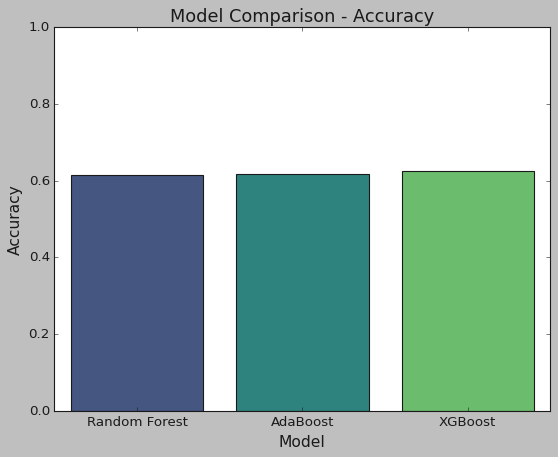

In [29]:
# Models to compare
models = {
    'Random Forest': RandomForestClassifier(random_state=42),
    'AdaBoost': AdaBoostClassifier(random_state=42),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
}

# Variables to track the best model and its accuracy
best_model = None
best_accuracy = 0

# Lists to store model names and accuracies for plotting
model_names = []
accuracies = []

# Loop through each model, train, and evaluate
for model_name, model in models.items():
    print(f"\nEvaluating {model_name}...\n")

    # Create the pipeline
    model_pipeline = Pipeline([
        ('preprocessing', preprocessor),
        ('feature_selection', k_best),
        ('classifier', model)
    ])

    # Fit the model
    model_pipeline.fit(X_train, y_train)

    # Predictions
    y_pred = model_pipeline.predict(X_val)

    # Accuracy score
    accuracy = accuracy_score(y_val, y_pred)
    print(f'Accuracy for {model_name}: {accuracy:.4f}')

    # Update best model if current model has higher accuracy
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model = model_name

    # Classification report (Precision, Recall, F1-score)
    print("\nClassification Report:")
    print(classification_report(y_val, y_pred))

    # Append model name and accuracy to the lists for comparison
    model_names.append(model_name)
    accuracies.append(accuracy)

# Print the best model based on accuracy
print(f"\nBest Model: {best_model} with Accuracy: {best_accuracy:.4f}")

# Plotting the comparison of accuracy scores
plt.figure(figsize=(8, 6))
sns.barplot(x=model_names, y=accuracies, palette='viridis')
plt.title('Model Comparison - Accuracy', fontsize=16)
plt.xlabel('Model', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.ylim(0, 1)
plt.show()

# Hyper Parameter Tuning

Hyperparameter tuning for finding the best parameters for a given model to optimize its performance. Using RandomizedSearchCV, which performs a random search over specified hyperparameter values and selects the best combination based on cross-validation scores.

## Defining parameter grid

To begin, defining a grid of hyperparameters that you want to test. This grid contains various values for different parameters that could improve the model's performance.

In [30]:
param_dist = {
    'classifier__n_estimators': np.arange(300, 601, 50),
    'classifier__max_depth': [3, 4, 5, 6],
    'classifier__learning_rate': [0.03, 0.05, 0.1],
    'classifier__subsample': [0.7, 0.8, 0.9],
    'classifier__colsample_bytree': [0.7, 0.8, 0.9, 1.0],
    'classifier__gamma': [0, 2, 5],
    'classifier__reg_alpha': [0, 0.1, 0.5],
    'classifier__reg_lambda': [1, 1.5, 2]
}

## Using RandomizedSearchCV

RandomizedSearchCV performs the search over the parameter grid using cross-validation and selects the best parameters based on the performance metric.

In [31]:
random_search = RandomizedSearchCV(
    estimator=XGB_model,
    param_distributions=param_dist,
    n_iter=50,
    scoring='roc_auc',
    cv=5,
    verbose=2,
    n_jobs=-1,
    random_state=42
)

## Fitting the model

After optimizing the hyperparameters using RandomizedSearchCV, the next step is to fit the model to the training data. This process involves using the best set of parameters that provide the most accurate model based on the training dataset, allowing it to learn patterns and relationships within the data.

In [32]:
random_search.fit(X_train, y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('preprocessing',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('num',
                                                                               Pipeline(steps=[('imputer',
                                                                                                SimpleImputer()),
                                                                                               ('scaler',
                                                                                                StandardScaler())]),
                                                                               ['IsBetaUser',
                                                                                'RealTimeProtectionState',
                                                                                'IsPassiveModeEnabled',
                                                                                'AntivirusConfigID',
                                                                                'NumAntivirusProductsInstalled',
                                                                                'NumAntivirusProductsEnabled',
                                                                                '...
                   param_distributions={'classifier__colsample_bytree': [0.7,
                                                                         0.8,
                                                                         0.9,
                                                                         1.0],
                                        'classifier__gamma': [0, 2, 5],
                                        'classifier__learning_rate': [0.03,
                                                                      0.05,
                                                                      0.1],
                                        'classifier__max_depth': [3, 4, 5, 6],
                                        'classifier__n_estimators': array([300, 350, 400, 450, 500, 550, 600]),
                                        'classifier__reg_alpha': [0, 0.1, 0.5],
                                        'classifier__reg_lambda': [1, 1.5, 2],
                                        'classifier__subsample': [0.7, 0.8,
                                                                  0.9]},
                   random_state=42, scoring='roc_auc', verbose=2)

## Best parameters & ROC AUC score

The ROC AUC score giving us a measure of the model's ability to correctly classify instances from both classes, with a higher score reflecting better model performance, especially in distinguishing between the target classes.

In [33]:
print("Best Parameters:", random_search.best_params_)
print("Best ROC AUC Score:", random_search.best_score_)

Best Parameters: {'classifier__subsample': 0.9, 'classifier__reg_lambda': 2, 'classifier__reg_alpha': 0, 'classifier__n_estimators': 600, 'classifier__max_depth': 6, 'classifier__learning_rate': 0.03, 'classifier__gamma': 2, 'classifier__colsample_bytree': 0.7}
Best ROC AUC Score: 0.6806172603306366


## Use the best model and ROC Curve

With the hyperparameter tuning complete, we now take the best model found during the RandomizedSearchCV process and use it for making predictions.

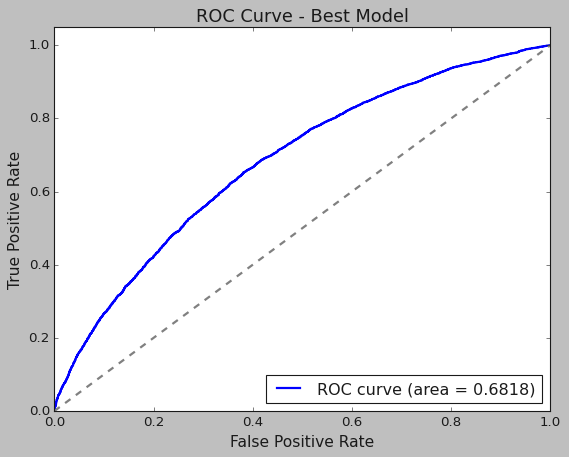

In [34]:
best_model = random_search.best_estimator_
# Predict probabilities on the validation set
y_pred_prob = best_model.predict_proba(X_val)[:, 1]

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_val, y_pred_prob)
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')  # Diagonal line
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=14)
plt.ylabel('True Positive Rate', fontsize=14)
plt.title(f'ROC Curve - Best Model', fontsize=16)
plt.legend(loc='lower right')
plt.show()

## Predictions on validation set

After selecting the best model, we use it to finally predict the target variable on the validation set.

In [35]:
y_pred = best_model.predict(X_val)

# Predictions on validation set
y_pred = best_model.predict(X_val)

# Evaluate performance
accuracy = accuracy_score(y_val, y_pred)
print('Validation Accuracy:', accuracy)

# Generate Predictions
Y_test_pred = best_model.predict(X_test)

Validation Accuracy: 0.6344818376068376


# Create Submission File


In [36]:
submission = pd.DataFrame({
    'id': range(len(test_data)), 
    'target': Y_test_pred
})
submission.to_csv('/kaggle/working/submission.csv', index=False)
print("Submission file created successfully!")

Submission file created successfully!
